take the data open, high, low, close and get exponentially decreasing price distributions

In [1]:

%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
import pandas as pd
from scipy.stats import laplace

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

import os
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt


In [2]:

# Read the CSV file using the semicolon as the delimiter
dir_name = "data"
filename = f"{dir_name}/btc_usd_hourly_kraken.csv"

df = pd.read_csv(filename, index_col='timestamp', parse_dates=True)
df = df[['open', 'high', 'low', 'close']].dropna()

#df = pd.read_csv(filename, delimiter=';')
df = pd.read_csv(filename)

df

,timestamp,open,high,low,close,volume
0,2025-03-31 00:00:00,82325.4,82398.9,81270.3,81586.1,98.769296
1,2025-03-31 01:00:00,81587.0,82248.8,81549.1,81983.0,39.315732
2,2025-03-31 02:00:00,81983.0,82117.0,81666.1,81913.1,37.398661
3,2025-03-31 03:00:00,81913.2,82021.2,81500.0,81508.6,17.335940
4,2025-03-31 04:00:00,81508.6,81850.0,81426.2,81850.0,20.308289
...,...,...,...,...,...,...
715,2025-04-29 19:00:00,95434.0,95434.0,95261.2,95347.0,39.532807
716,2025-04-29 20:00:00,95347.0,95365.4,94881.6,94881.6,186.533168
717,2025-04-29 21:00:00,94881.7,94973.5,94395.5,94762.8,194.907747
718,2025-04-29 22:00:00,94762.8,94762.8,94100.0,94198.4,40.465864


In [3]:


"""
Process order book data for a single product with all requested features.

Returns:
    dict: Contains all processed data and metrics
"""



# Histogram setup
bin_width = 0.1
bin_range = 8
bins = np.arange(-bin_range * bin_width, (bin_range + 1) * bin_width, bin_width)
bin_centers = (bins[:-1] + bins[1:]) / 2
n_bins = len(bin_centers)

# Histograms (decayed over time)
hist_open = np.zeros(n_bins)
hist_high = np.zeros(n_bins)
hist_low = np.zeros(n_bins)
hist_close = np.zeros(n_bins)

# Parameters
decay_rate = 0.9  # exponential decay factor

In [4]:


# Initialization
hist_combined = np.zeros(n_bins)
histogram_vectors = []
price_deltas = []

# Loop through frames
for frame in range(len(df)):
    row = df.iloc[frame]

    base_price = row["open"]
    prices = np.array([row["open"], row["high"], row["low"], row["close"]])
    deltas = prices - base_price

    price_deltas.extend(deltas)  # accumulate for Laplace fit

    # Apply decay
    hist_combined *= decay_rate

    # Update histogram
    hist_combined += np.histogram(deltas, bins=bins)[0]

    histogram_vectors.append((hist_combined.copy(), price_deltas.copy()))

# --- Plot Setup ---
fig, ax = plt.subplots()
bar = ax.bar(bin_centers, histogram_vectors[0][0], width=bin_width, alpha=0.6, label="Combined Histogram")
laplace_line, = ax.plot([], [], 'r-', lw=2, label="Laplace Fit")
ax.set_xlim(bin_centers[0], bin_centers[-1])
ax.set_ylim(0, max([np.max(h[0]) for h in histogram_vectors]) * 1.1)
ax.set_xlabel("Price Delta from Open")
ax.set_ylabel("Frequency")
ax.legend()

def fit_asymmetric_laplace_from_histogram(bin_centers, counts, loc=0):
    counts = np.asarray(counts)
    x = bin_centers - loc

    left = x < 0
    right = x >= 0

    weights_left = counts[left]
    weights_right = counts[right]

    x_left = np.abs(x[left])
    x_right = np.abs(x[right])

    # Prevent division by zero
    if np.sum(weights_left) > 0:
        b_left = np.sum(weights_left * x_left) / np.sum(weights_left)
    else:
        b_left = 0.05

    if np.sum(weights_right) > 0:
        b_right = np.sum(weights_right * x_right) / np.sum(weights_right)
    else:
        b_right = 0.05

    return b_left, b_right



def update(frame):
    hist, _ = histogram_vectors[frame]

    # Update bars
    for b, val in zip(bar, hist):
        b.set_height(val)

    # Asymmetric Laplace fit
    b_left, b_right = fit_asymmetric_laplace_from_histogram(bin_centers, hist, loc=0)

    x = np.linspace(bin_centers[0], bin_centers[-1], 300)
    y = np.zeros_like(x)

    # Build asymmetric PDF manually
    for i, xi in enumerate(x):
        if xi < 0:
            y[i] = 0.5 * np.exp(xi / b_left) / b_left
        else:
            y[i] = 0.5 * np.exp(-xi / b_right) / b_right

    # Normalize to match histogram area
    y *= np.sum(hist) * bin_width

    laplace_line.set_data(x, y)
    ax.set_title(f"Frame {frame} | Asym Laplace b⁻={b_left:.2f}, b⁺={b_right:.2f}")
    return bar, laplace_line




# --- Animate & Save ---
ani = animation.FuncAnimation(fig, update, frames=len(histogram_vectors), interval=100)

# To save as MP4
ani.save("histogram_animation.mp4", fps=30)

# To display inline in Jupyter
from IPython.display import HTML
HTML(ani.to_jshtml())




<IPython.core.display.Javascript object>

Animation size has reached 20989100 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# LLOYD-MAX QUANTIZATION

In [5]:
import numpy as np
import pandas as pd
from scipy.stats import laplace

# Configurable parameters
n_centroids = 8  # Number of quantization centroids
bin_range = 8

decay_rate = 0.9
bin_width = 0.1

bins = np.arange(-bin_range * bin_width, (bin_range + 1) * bin_width, bin_width)
bin_centers = (bins[:-1] + bins[1:]) / 2
n_bins = len(bin_centers)

# Histograms
hist_combined = np.zeros(n_bins)
histogram_vectors = []

# Example dataframe if not defined
# df = pd.DataFrame({
#     "open": np.random.normal(100, 1, 200),
#     "high": np.random.normal(101, 1, 200),
#     "low": np.random.normal(99, 1, 200),
#     "close": np.random.normal(100, 1, 200),
# })

# Laplace + Quantizer helpers
def fit_asymmetric_laplace_from_histogram(bin_centers, counts, loc=0):
    counts = np.asarray(counts)
    x = bin_centers - loc
    left = x < 0
    right = x >= 0
    weights_left = counts[left]
    weights_right = counts[right]
    x_left = np.abs(x[left])
    x_right = np.abs(x[right])
    b_left = np.sum(weights_left * x_left) / np.sum(weights_left) if np.sum(weights_left) > 0 else 0.05
    b_right = np.sum(weights_right * x_right) / np.sum(weights_right) if np.sum(weights_right) > 0 else 0.05
    return b_left, b_right

def lloyd_max_quantizer(x, pdf, n_centroids, max_iter=5000, tol=1e-5):
    pmf = pdf / np.sum(pdf)
    centroids = np.linspace(x.min(), x.max(), n_centroids)
    for _ in range(max_iter):
        boundaries = np.convolve(centroids, [0.5, 0.5], mode='valid')
        partitions = np.digitize(x, boundaries)
        new_centroids = []
        for k in range(n_centroids):
            mask = partitions == k
            if np.any(mask):
                weights = pmf[mask]
                new_centroids.append(np.sum(x[mask] * weights) / np.sum(weights))
            else:
                new_centroids.append(centroids[k])
        new_centroids = np.array(new_centroids)
        if np.allclose(new_centroids, centroids, atol=tol):
            break
        centroids = new_centroids
    return centroids

# Store all centroids
centroid_array = []

# Main loop over frames
for frame in range(len(df)):
    row = df.iloc[frame]
    base_price = row["open"]
    prices = np.array([row["open"], row["high"], row["low"], row["close"]])
    deltas = prices - base_price

    hist_combined *= decay_rate
    hist_combined += np.histogram(deltas, bins=bins)[0]

    hist = hist_combined.copy()
    b_left, b_right = fit_asymmetric_laplace_from_histogram(bin_centers, hist, loc=0)

    x = np.linspace(bin_centers[0], bin_centers[-1], 300)
    y = np.where(x < 0,
                 0.5 * np.exp(x / b_left) / b_left,
                 0.5 * np.exp(-x / b_right) / b_right)
    y *= np.sum(hist) * bin_width  # Normalize to histogram mass

    centroids = lloyd_max_quantizer(x, y, n_centroids)
    centroid_array.append(centroids)

# Add to dataframe
df["laplace_centroids"] = centroid_array


In [6]:
df['laplace_centroids'].iloc[0]

array([-0.245686  , -0.14147947, -0.07441037, -0.0209997 ,  0.0209997 ,
        0.07441037,  0.14147947,  0.245686  ])

In [7]:


from sklearn.cluster import KMeans
import numpy as np

def cluster_centroids(centroid_series, n_clusters=5, random_state=42):
    """
    Cluster per-frame centroid vectors using KMeans and return cluster labels,
    the fitted model, and a nearest-neighbor quantizer function.
    """
    # Convert to 2D matrix: (n_frames, n_centroids)
    centroid_matrix = np.stack(centroid_series.to_numpy())

    # Fit KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
    labels = kmeans.fit_predict(centroid_matrix)

    # Define nearest-neighbor quantizer
    def quantize_centroids(new_centroids):
        new_centroids = np.atleast_2d(new_centroids)
        return kmeans.predict(new_centroids)

    return labels, kmeans, quantize_centroids



# Run clustering
labels, kmeans_model, quantize_centroids = cluster_centroids(df["laplace_centroids"], n_clusters=6)
df["laplace_cluster"] = labels


# Print cluster centers
print("Cluster Centers:\n", kmeans_model.cluster_centers_)

# Map a new centroid vector to the nearest cluster
example = df["laplace_centroids"].iloc[-1]
cluster_id = quantize_centroids(example)
print("Nearest cluster for last frame:", cluster_id[0])

Cluster Centers:
 [[-0.63906297 -0.44606688 -0.27499574 -0.12447888  0.00523218  0.05734495
   0.12452027  0.22926503]
 [-0.55245616 -0.34459852 -0.19935552 -0.08590332  0.00239906  0.0547195
   0.12217876  0.22718179]
 [-0.26054952 -0.14866068 -0.07780447 -0.02335777  0.01919768  0.07237553
   0.13953151  0.24417955]
 [-0.49611247 -0.29777647 -0.16920065 -0.0706497   0.0052338   0.05786988
   0.12495195  0.22926695]
 [-0.4333725  -0.25285179 -0.14051606 -0.05674907  0.00766772  0.06084016
   0.12897679  0.23587099]
 [-0.60302336 -0.39681728 -0.23548116 -0.10378059  0.00221937  0.05436059
   0.12144476  0.22577548]]
Nearest cluster for last frame: 4


# find good clusters

In [11]:
# Precompute midprice for each row
df["mid_price"] = df[["open", "high", "low", "close"]].median(axis=1)

# Store results
cluster_success_counts = {}
cluster_total_counts = {}

# Loop over each row (time step)
for i in range(len(df)):
    cluster = df.loc[i, "laplace_cluster"]
    midpoint = df.loc[i, "mid_price"]
    upper = 1.05 * midpoint
    lower = 0.95 * midpoint

    # Look ahead in time
    future_prices = df.loc[i+1:, "mid_price"].values

    hit_upper = np.argmax(future_prices >= upper) if np.any(future_prices >= upper) else None
    hit_lower = np.argmax(future_prices <= lower) if np.any(future_prices <= lower) else None

    success = False
    if hit_upper is not None and hit_lower is not None:
        success = hit_upper < hit_lower  # rises before it falls
    elif hit_upper is not None:
        success = True  # only rises
    else:
        success = False  # never rises

    # Tally
    cluster_total_counts[cluster] = cluster_total_counts.get(cluster, 0) + 1
    if success:
        cluster_success_counts[cluster] = cluster_success_counts.get(cluster, 0) + 1

# Compute success ratios
success_ratios = {}
for cluster in cluster_total_counts:
    total = cluster_total_counts[cluster]
    success = cluster_success_counts.get(cluster, 0)
    ratio = success / total
    success_ratios[cluster] = ratio

# Display as DataFrame
summary_df = pd.DataFrame({
    "cluster": list(success_ratios.keys()),
    "success_ratio": list(success_ratios.values()),
    "successes": [cluster_success_counts.get(c, 0) for c in success_ratios],
    "total": [cluster_total_counts[c] for c in success_ratios]
}).sort_values("success_ratio", ascending=False)

print(summary_df)


   cluster  success_ratio  successes  total
4        0       1.000000         56     56
5        5       0.956522         44     46
3        3       0.660000         33     50
1        1       0.485477        234    482
0        2       0.304348         14     46
2        4       0.050000          2     40


# Stop loss simulation

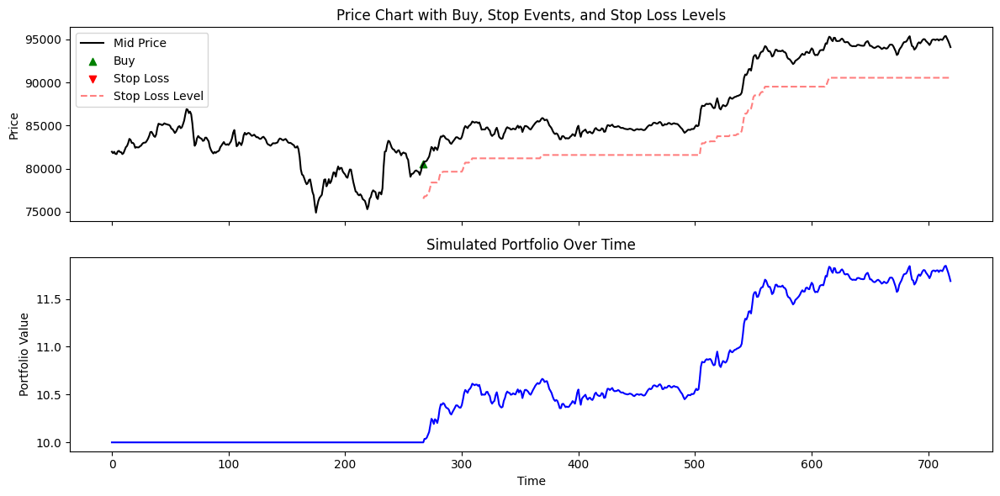

In [14]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# --- Setup ---
cash = 10
position = 0
entry_price = 0
trailing_high = 0
stop_loss_price = 0

portfolio_values = []
stoploss_lines = []
price_series = df["mid_price"].values
cluster_series = df["laplace_cluster"].values

entry_indices = []
exit_indices = []

for i in range(len(df)):
    price = price_series[i]
    cluster = cluster_series[i]

    if position == 0:
        if cluster in [0, 5]:
            entry_price = price
            trailing_high = price
            stop_loss_price = price * 0.95
            position = 1
            entry_indices.append(i)

    else:
        if price > trailing_high * 1.001:
            trailing_high = price
            stop_loss_price = trailing_high * 0.95

        if price < stop_loss_price:
            cash = cash * (price / entry_price)
            position = 0
            exit_indices.append(i)

    if position == 1:
        portfolio_value = cash * (price / entry_price)
        stoploss_lines.append(stop_loss_price)
    else:
        portfolio_value = cash
        stoploss_lines.append(np.nan)

    portfolio_values.append(portfolio_value)

# Update dataframe
df["portfolio_value"] = portfolio_values
df["stop_loss_line"] = stoploss_lines




fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6), sharex=True)

# Price chart
ax1.plot(df.index, price_series, label='Mid Price', color='black')
ax1.scatter(df.index[entry_indices], price_series[entry_indices], color='green', label='Buy', marker='^')
ax1.scatter(df.index[exit_indices], price_series[exit_indices], color='red', label='Stop Loss', marker='v')

# Plot stop-loss levels
ax1.plot(df.index, df["stop_loss_line"], color='red', linestyle='--', alpha=0.5, label='Stop Loss Level')

ax1.set_ylabel("Price")
ax1.legend()
ax1.set_title("Price Chart with Buy, Stop Events, and Stop Loss Levels")

# Portfolio value
ax2.plot(df.index, df["portfolio_value"], color='blue')
ax2.set_ylabel("Portfolio Value")
ax2.set_xlabel("Time")
ax2.set_title("Simulated Portfolio Over Time")

plt.tight_layout()
plt.show()
